<a href="https://colab.research.google.com/github/201524495/201524495/blob/main/evaluation_tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Evaluation Metric for Generative Models

### 환경설정

In [1]:
!pip install diffusers transformers accelerate torch torchvision torchmetrics[image] pytorch-fid lpips matplotlib datasets "clip @ git+https://github.com/openai/CLIP.git" --quiet

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 102.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 94.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 61.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 102.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 4.6 MB/s eta 0:00:00
  

In [2]:
import matplotlib.pyplot as plt
import numpy as np

# Reusable function to display images in a grid with only one overall title (suptitle)
def display_images(images, rows=2, cols=None, figsize=(20, 8), suptitle=None, suptitle_fontsize=25):
    """
    Display a grid of images using matplotlib with only a single overall title.

    Parameters:
    - images: list of PIL Images or numpy arrays
    - rows: number of rows in the grid (default: 2)
    - cols: number of columns (optional; auto-calculated if None)
    - figsize: figure size (adjusted larger for 10 images)
    - suptitle: overall figure title (optional, but recommended for the single title)
    - suptitle_fontsize: font size for the overall title (increased for visibility)
    """

    if cols is None:
        cols = (len(images) + rows - 1) // rows  # Auto-calculate columns based on rows

    if len(images) > rows * cols:
        raise ValueError("Not enough grid space for all images")

    fig, axs = plt.subplots(rows, cols, figsize=figsize)
    axs = axs.flatten() if rows * cols > 1 else [axs]

    for i, ax in enumerate(axs):
        if i < len(images):
            # Convert PIL to numpy if necessary
            img = images[i]
            if hasattr(img, 'convert'):  # If PIL Image
                img = img.convert('RGB')
                img = np.array(img)
            ax.imshow(img)
            ax.axis('off')
            # No individual titles
        else:
            ax.axis('off')  # Hide unused subplots

    if suptitle:
        fig.suptitle(suptitle, y=1.02, fontsize=suptitle_fontsize)  # Single overall title with adjustable size

    plt.tight_layout(pad=0.5, h_pad=0.5, w_pad=0.5)  # Tighten overall layout with reduced pads
    plt.show()

### Generate GT and fake images

In [3]:
import torch
from diffusers import StableDiffusionPipeline, StableDiffusionImg2ImgPipeline
from datasets import load_dataset
import torchvision.transforms as transforms
from PIL import Image
from tqdm import tqdm

# --- 모델 로드 ---
# Text-to-Image 파이프라인
pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5",
    torch_dtype=torch.float16
)
device = "cuda" if torch.cuda.is_available() else "cpu"
pipe = pipe.to(device)

print(f"Using device: {device}")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

safety_checker/model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Using device: cuda


In [ ]:
def generate(pipe, prompts, num_inference_steps=100, guidance_scale=7.5):
    """
    PIL image들의 list를 return하는 함수 작성

    https://huggingface.co/docs/diffusers/api/pipelines/stable_diffusion/text2img 를 참고
    """
    images = []
    generator = torch.Generator(device=pipe.device).manual_seed(42)  # Set generator seed
    for prompt in prompts:  # Generate 10 GT images
        pipe(prompt
             , guidance_scale=guidance_scale
             , num_inference_steps=50
             , generator=generator).images[0]

    return images

In [ ]:
prompts = ["a photo of a cat"] * 10

# cfg = 7.5, num_steps=100 일 때를 GT라고 가정
gt_images = generate(pipe, prompts, num_inference_steps=100, guidance_scale=7.5)
fake_images_50 = generate(pipe, prompts, num_inference_steps=50, guidance_scale=7.5)
fake_images_10 = generate(pipe, prompts, num_inference_steps=10, guidance_scale=7.5)
fake_images_50_1 = generate(pipe, prompts, num_inference_steps=50, guidance_scale=1)
fake_images_50_12 = generate(pipe, prompts, num_inference_steps=50, guidance_scale=12)

# visualization
display_images(gt_images, suptitle="GT")
display_images(fake_images_50, suptitle="50 steps")
display_images(fake_images_10, suptitle="10 steps")

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

### (Unpaired Image) Evaluation Metrics: FID, CLIP

#### FID (Lower is better)
image set 1, 2 사이의 분포 거리를 측정

1. InceptionV3 를 통해 각 set의 feature 추출
   - ImageNet에서 classification을 위해 학습.
2. 각 set의 features가 Normal distribution이라는 가정하에, 평균과 공분산 추출
3. Frechet distance를 계산
   - $\text{FID} =||\mu_1 - \mu_2||^2 + Tr(\Sigma_1 + \Sigma_2 - 2 * ($

In [ ]:
import torch
import torch.nn as nn
import numpy as np
from PIL import Image
import torchvision.transforms as T
from scipy import linalg
from tqdm import tqdm
from pytorch_fid.inception import InceptionV3


# --- FID (Fréchet Inception Distance) ---
# 개념: 두 이미지 집단의 feature 분포 사이의 거리를 측정합니다.
# InceptionV3 모델로 추출한 feature들의 평균(mu)과 공분산(sigma)을 이용합니다. 낮을수록 분포가 유사합니다.

# FID 계산을 위한 헬퍼 함수
def get_activations(image_list, model, batch_size=32, dims=2048):
    """InceptionV3 모델로부터 activation을 추출합니다."""
    model.eval()

    # InceptionV3는 (299, 299) 크기와 ImageNet 정규화를 필요로 합니다.
    transform = T.Compose([
        T.Resize((299, 299)),
        T.ToTensor(),
        T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    num_images = len(image_list)
    pred_arr = np.empty((num_images, dims))

    for i in tqdm(range(0, num_images, batch_size), desc="Getting activations"):
        batch_pil = image_list[i:i + batch_size]
        batch_tensor = torch.stack([transform(img) for img in batch_pil]).to(device)

        with torch.no_grad():
            pred = model(batch_tensor)[0]

        if pred.size(1) != dims:
            pred = F.adaptive_avg_pool2d(pred, output_size=(1, 1))

        pred_arr[i:i + batch_size] = pred.cpu().numpy().reshape(pred.size(0), -1)

    return pred_arr

def calculate_fid_stats(activations):
    """Activation으로부터 평균과 공분산을 계산합니다."""
    mu = pass
    sigma = pass #use np.cov
    return mu, sigma

def manual_calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Frechet 거리를 직접 계산하는 공식 구현."""
    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)
    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, "Means must have the same shape"
    assert sigma1.shape == sigma2.shape, "Covariances must have the same shape"

    diff = pass

    # 공분산 행렬의 곱의 제곱근 계산
    covmean, _ = pass # use linalg.sqrtm

    tr_covmean = pass

    return pass

def manual_fid(real_imgs, fake_imgs):
    """FID를 수동으로 계산합니다."""
    # InceptionV3 모델 로드 (pytorch-fid 패키지에서 제공하는 것 사용)
    block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[2048]
    model = InceptionV3([block_idx]).to(device)

    # 각 이미지 집단에 대한 activation 추출
    act_real = pass
    act_fake = pass

    # 평균과 공분산 계산
    mu_real, sigma_real = pass
    mu_fake, sigma_fake = pass

    # Frechet 거리 계산
    fid_value = pass

    return fid_value

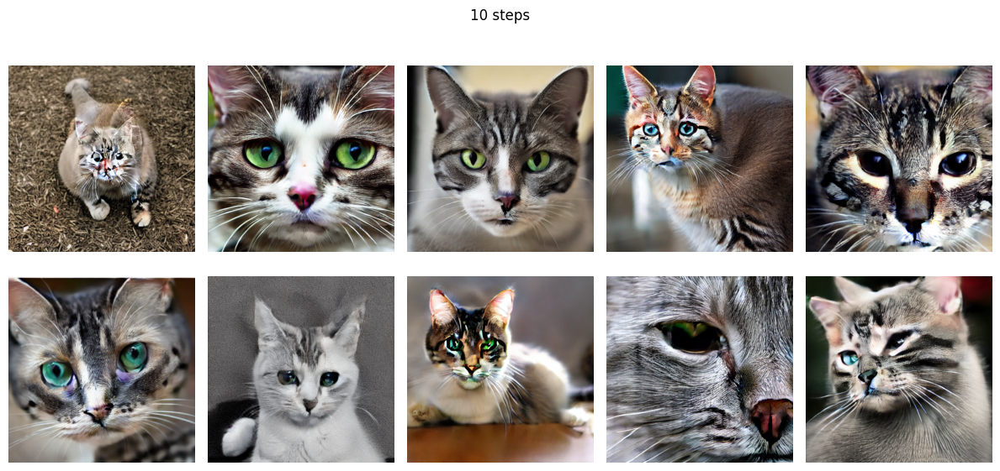


--- Comparing FID (Lower is better) ---


Getting activations: 100%|██████████| 1/1 [00:00<00:00, 19.85it/s]


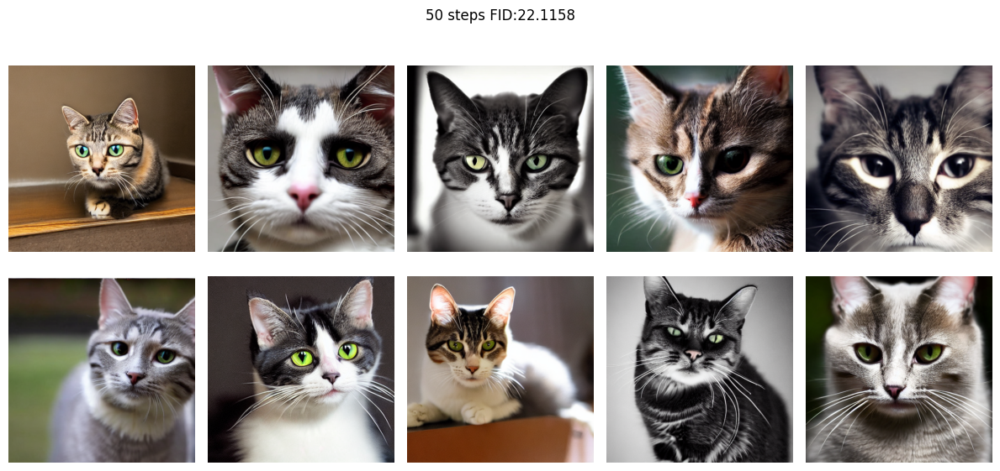

Getting activations: 100%|██████████| 1/1 [00:00<00:00, 22.62it/s]


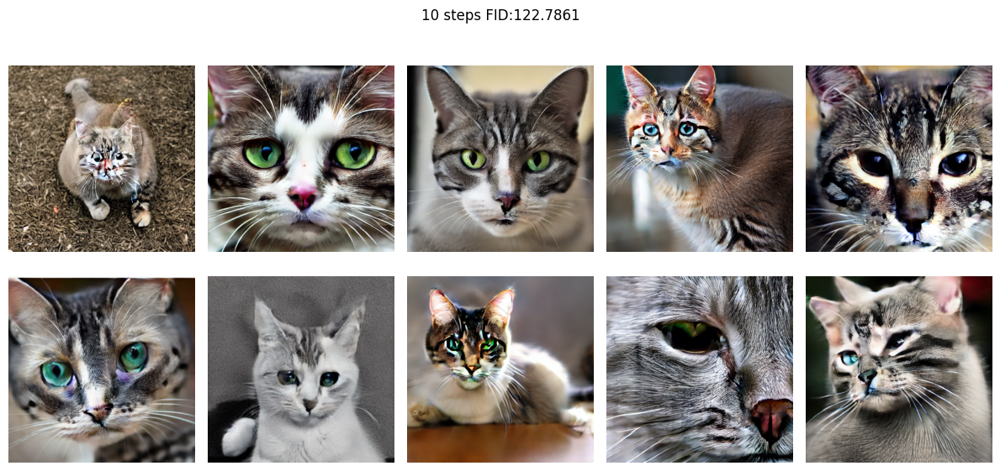

In [ ]:
print("\n--- Comparing FID (Lower is better) ---")

# FID는 이미지 수가 많아야 의미가 있습니다.
fid_manual = manual_fid(gt_images, fake_images_50)
display_images(fake_images_50, suptitle=f"50 steps, FID:{fid_manual:.4f}")

fid_manual = manual_fid(gt_images, fake_images_10)
display_images(fake_images_10, suptitle=f"10 steps, FID:{fid_manual:.4f}")


#### CLIP score (높을수록 좋음)
(image, text) pair의 유사도 측정

1. image feature 와 text feature를 뽑아냄
2. image feature 와 text feature 사이의 consine similarity 측정


In [ ]:
import clip
# --- CLIP Score ---
# 개념: 생성된 이미지(fake_images)와 해당 이미지를 생성하는 데 사용된 텍스트 프롬프트(prompts)
#       간의 의미론적 유사도를 측정합니다. 값이 높을수록 프롬프트를 잘 따르는 이미지입니다.

def manual_clip_score(images, prompts):
    """CLIP Score를 이미지-텍스트 쌍에 대해 하나씩 수동으로 계산합니다."""
    model, preprocess = clip.load("ViT-B/32", device=device)

    total_score = 0.0
    num_pairs = len(images)

    for pil_image, prompt in tqdm(zip(images, prompts), total=num_pairs, desc="Manual CLIP Score"):
        # 이미지와 텍스트를 각각 전처리하고 토큰화
        image_input = preprocess(pil_image).unsqueeze(0).to(device)
        text_input = clip.tokenize([prompt]).to(device)

        with torch.no_grad():
            # 이미지와 텍스트의 feature embedding 추출
            image_features = model.encode_image(pass)
            text_features = model.encode_text(pass)

            # L2 정규화 (코사인 유사도 계산을 위해)
            eps=1e-8
            image_features /= pass
            text_features /= pass

            # 코사인 유사도 계산 후 100을 곱함 (일반적인 스케일링)
            similarity = pass
            score = 100.0 * similarity
            total_score += score

    return total_score / num_pairs

--- Comparing CLIP Score (Higher is better) ---


Manual CLIP Score: 100%|██████████| 10/10 [00:00<00:00, 72.96it/s]


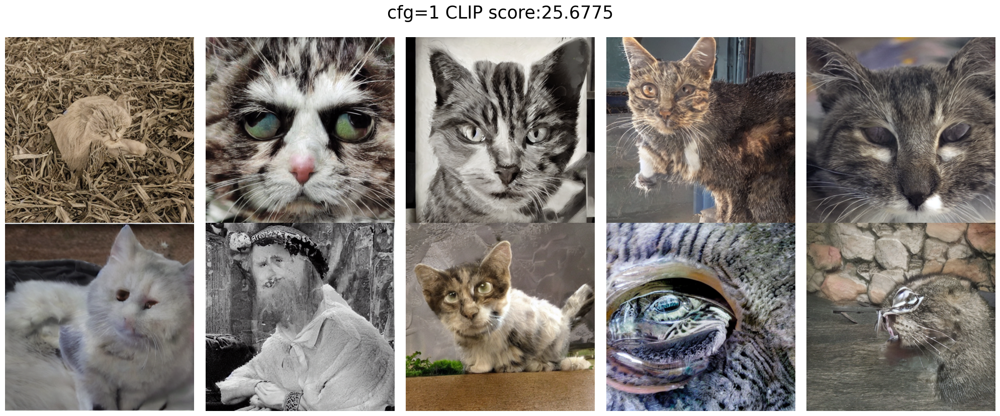

Manual CLIP Score: 100%|██████████| 10/10 [00:00<00:00, 75.03it/s]


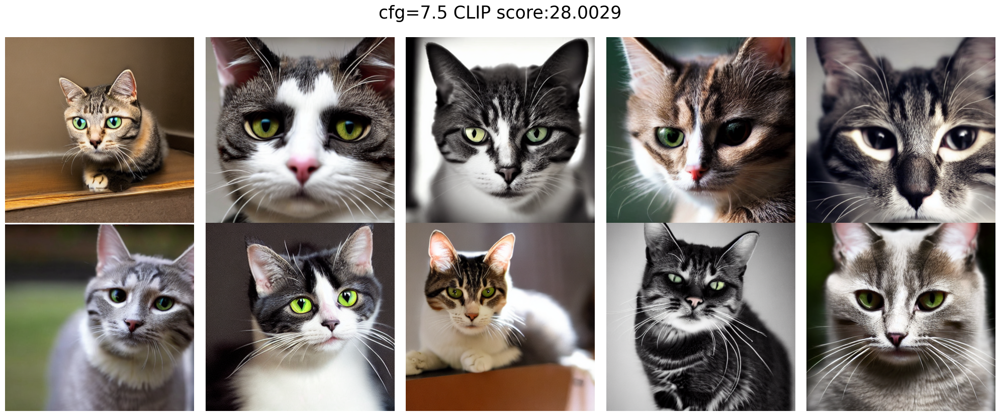

Manual CLIP Score: 100%|██████████| 10/10 [00:00<00:00, 75.42it/s]


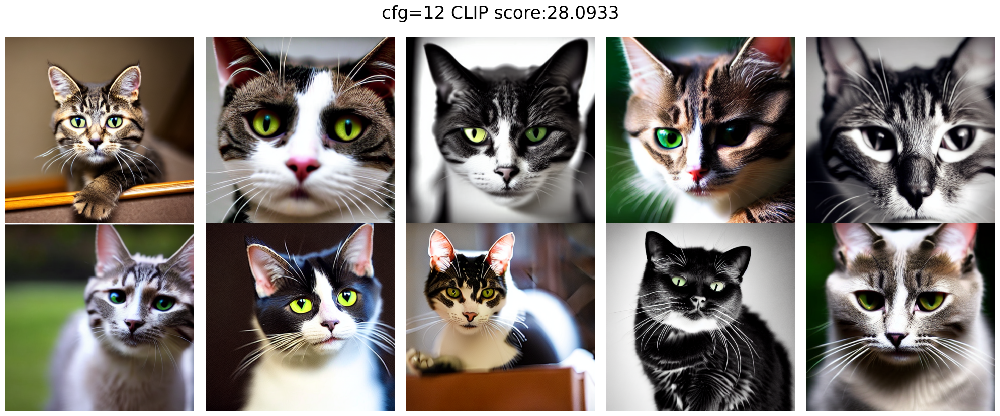

In [ ]:
# --- CLIP Score 비교 ---
print("--- Comparing CLIP Score (Higher is better) ---")
prompt= "a photo of a cat"

clip_manual = manual_clip_score(fake_images_50_1, prompts)
display_images(fake_images_50_1, suptitle=f"cfg=1, CLIP score:{clip_manual:.4f}")
ㅡ
clip_manual = manual_clip_score(fake_images_50, prompts)
display_images(fake_images_50, suptitle=f"cfg=7.5, CLIP score:{clip_manual:.4f}")

clip_manual = manual_clip_score(fake_images_50_12, prompts)
display_images(fake_images_50_12, suptitle=f"cfg=12, CLIP score:{clip_manual:.4f}")

### (Paired Imamge) Evaluation Metrics : PSNR, LPIPS

#### PSNR (높을수록 좋음)

$\text{PSNR} = 20 * \log_{10}(MAX_I/ \sqrt{MSE})$. ($MAX_I$는 image pixel의 최댓값)

In [ ]:
# --- PSNR (Peak Signal-to-Noise Ratio) ---
# 개념: 두 이미지 사이의 픽셀 단위 오차를 기반으로 하는 품질 측정 지표. 값이 클수록 원본과 유사합니다.
# 공식: 20 * log10(MAX_I / sqrt(MSE))

def manual_psnr(real_imgs, fake_imgs):
    """PSNR을 수동으로 계산합니다 (이미지 쌍의 평균)."""
    transform = T.ToTensor()
    total_psnr = 0.0
    num_images = len(real_imgs)

    for real_pil, fake_pil in zip(real_imgs, fake_imgs):
        # PIL 이미지를 [0, 1] 범위의 텐서로 변환
        real_t = transform(real_pil).to(device)
        fake_t = transform(fake_pil).to(device)

        mse = pass
        if mse == 0:
            return float('inf')

        # 데이터 범위가 [0, 1]이므로 MAX_I는 1.0
        max_pixel = 1.0
        psnr = pass
        total_psnr += psnr.item()

    return total_psnr / num_images

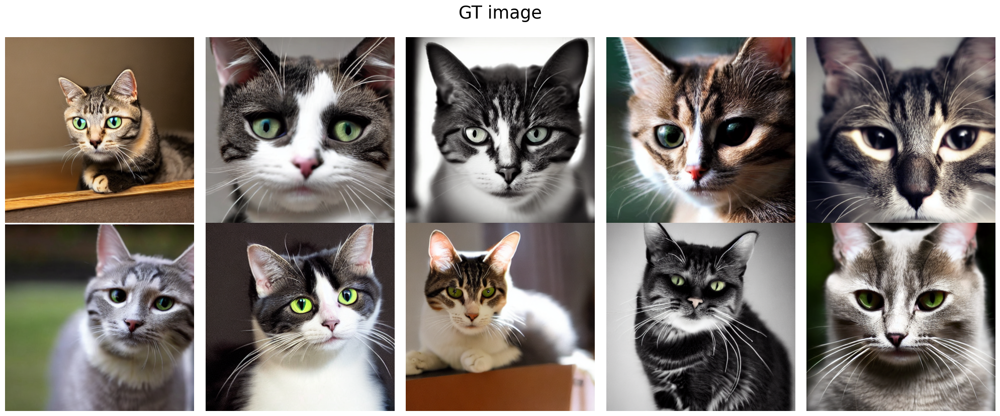


--- Comparing PSNR (Higher is better)---


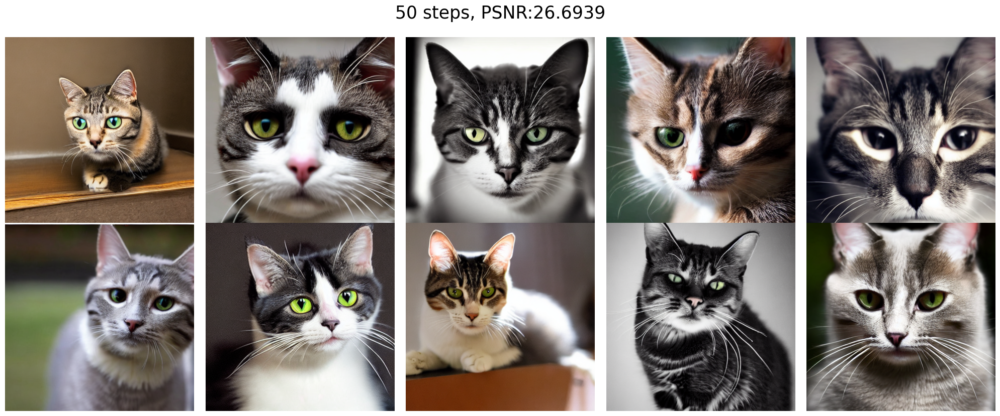

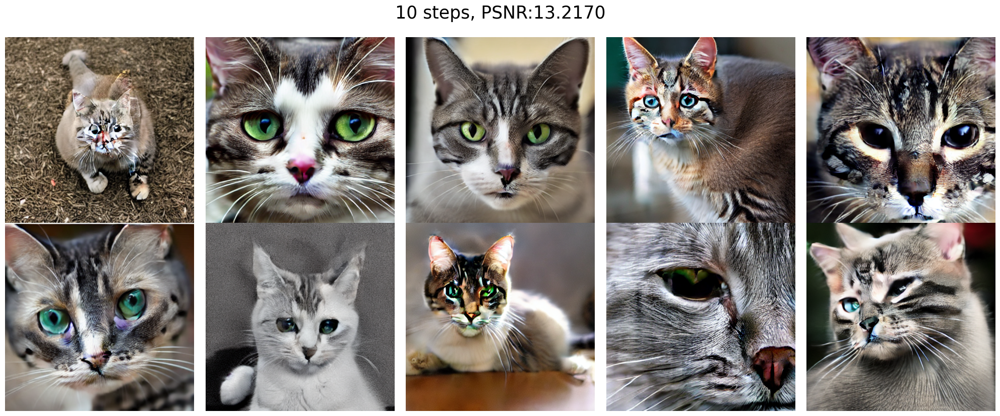

In [ ]:
# --- PSNR 비교 ---
display_images(gt_images, suptitle=f"GT image")

downsample_gt = [image.resize((128,128)).resize((512,512)) for image in gt_images]
psnr_manual = manual_psnr(gt_images, downsample_gt)
display_images(downsample_gt, suptitle=f"128x128, PSNR:{psnr_manual:.4f}")

print("\n--- Comparing PSNR (Higher is better)---")
psnr_manual = manual_psnr(gt_images, fake_images_50)
display_images(fake_images_50, suptitle=f"50 steps, PSNR:{psnr_manual:.4f}")

psnr_manual = manual_psnr(gt_images, fake_images_10)
display_images(fake_images_10, suptitle=f"10 steps, PSNR:{psnr_manual:.4f}")

#### LPIPS (낮을수록 좋음)

Perceptual metric (인간의 인식과 비슷) : Classification을 위해 학습된 네트워크의 중간 feature 의 유사도가 사람이 느끼는 두 이미지 간의 유사도와 비슷하다.

1. VGG를 가져온다
2. VGG(gt, fake)를 계산한다.
   - LPIPS model은 [-1,1]로 정규화된 입력을 기대한다.

In [ ]:
# --- LPIPS (Learned Perceptual Image Patch Similarity) ---
# 개념: 인간의 시각적 인식과 유사하게 이미지 유사성을 측정합니다.
# Pre-trained VGG 네트워크의 중간 feature map 간의 거리를 계산합니다. 낮을수록 유사합니다.
import lpips

def manual_lpips(real_imgs, fake_imgs):
    """LPIPS를 수동으로 계산합니다 (이미지 쌍의 평균)."""
    loss_fn_vgg = lpips.LPIPS(net='vgg').to(device)

    # LPIPS 모델은 [-1, 1] 범위로 정규화된 입력을 기대합니다.
    transform = T.Compose([
        T.ToTensor(),
        T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

    total_lpips = 0.0
    num_images = len(real_imgs)

    for real_pil, fake_pil in zip(real_imgs, fake_imgs):
        real_t = transform(real_pil).unsqueeze(0).to(device)
        fake_t = transform(fake_pil).unsqueeze(0).to(device)
        dist = loss_fn_vgg(pass, pass)
        total_lpips += dist.item()

    return total_lpips / num_images

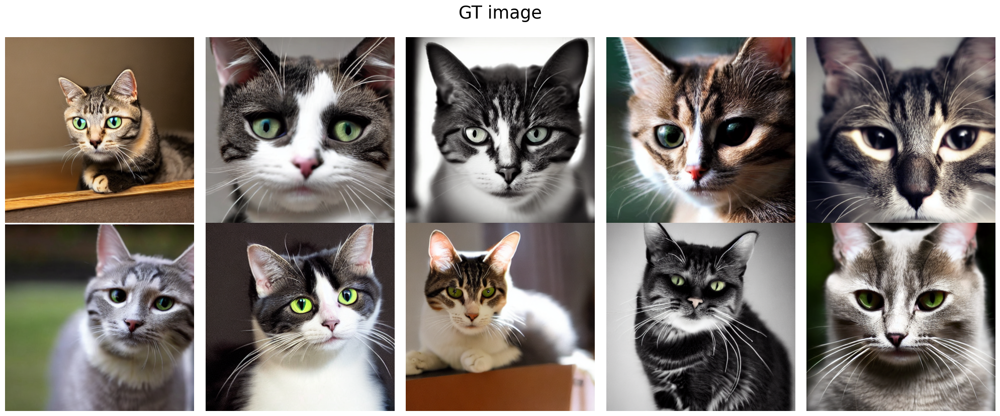


--- Comparing LPIPS (Lower is better)---
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


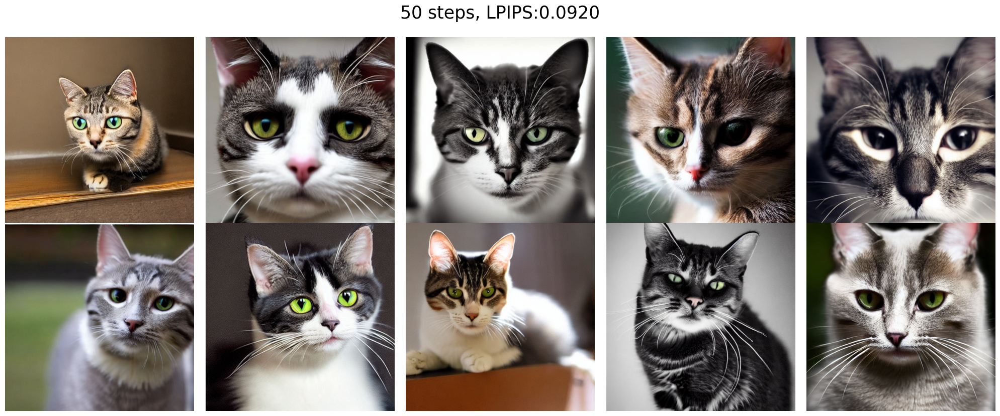

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/vgg.pth


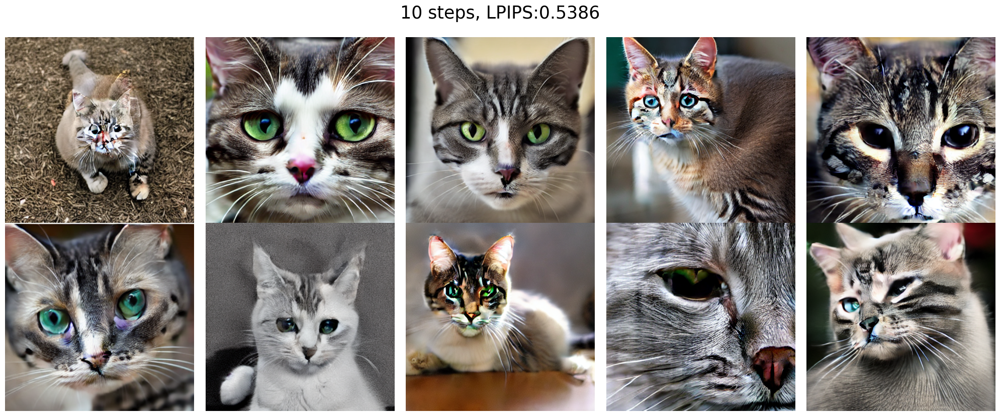

In [ ]:
# --- LPIPS 비교 ---
display_images(gt_images, suptitle=f"GT image")

print("\n--- Comparing LPIPS (Lower is better)---")
downsample_gt = [image.resize((128,128)).resize((512,512)) for image in gt_images]
lpips_manual = manual_lpips(gt_images, downsample_gt)
display_images(downsample_gt, suptitle=f"128x128, LPIPS:{lpips_manual:.4f}")

lpips_manual = manual_lpips(gt_images, fake_images_50)
display_images(fake_images_50, suptitle=f"50 steps, LPIPS:{lpips_manual:.4f}")

lpips_manual = manual_lpips(gt_images, fake_images_10)
display_images(fake_images_10, suptitle=f"10 steps, LPIPS:{lpips_manual:.4f}")